# **Análisis de datos acerca del precio de la electricidad en Colombia**
**Nombre:** Sergio Alejandro Cantillo Luna

# Librerías utilizadas

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import os, pathlib, glob, math
import warnings

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.figure_factory as ff
import matplotlib.pyplot as plt

from statsmodels.tsa.seasonal import seasonal_decompose, DecomposeResult
from statsmodels.tsa.stattools import adfuller, acf, pacf

from sklearn.preprocessing import MinMaxScaler, StandardScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

sns.set_context("paper")

# Manipulación de datos

## Carga de datos

In [2]:
data_dir = "PB"
data_dir = pathlib.Path(data_dir)
folder = list(data_dir.glob('*'))
print('Folder Structure:')
for f in folder:
    print(f)

Folder Structure:
PB\Precio_Bolsa_Nacional_($kwh)_2018.xlsx
PB\Precio_Bolsa_Nacional_($kwh)_2019.xlsx
PB\Precio_Bolsa_Nacional_($kwh)_2020.xlsx
PB\Precio_Bolsa_Nacional_($kwh)_2021.xlsx
PB\Precio_Bolsa_Nacional_($kwh)_2022.xlsx


In [3]:
datosPB = pd.DataFrame()
for f in sorted(glob.glob(str(data_dir)+"/*.xlsx")):
  df = pd.read_excel(f, engine='openpyxl', header=2)
  datosPB = pd.concat([datosPB,df], axis=0, sort=False, ignore_index=True)
datosPB = datosPB.dropna(axis=1)
datosPB = datosPB.drop(labels=['Fecha'],axis=1)
datosPB = pd.DataFrame({"Electricity_Bid_Price":datosPB.stack().reset_index(drop=True)})
rng = pd.date_range(start = '2018-01-01 00:00', end ='2022-12-31 23:00', freq='h')
datosPB = datosPB.set_index(rng)
print(datosPB.shape)
datosPB.head(5)

(43824, 1)


,Electricity_Bid_Price
2018-01-01 00:00:00,123.167294
2018-01-01 01:00:00,123.167294
2018-01-01 02:00:00,123.167294
2018-01-01 03:00:00,123.167294
2018-01-01 04:00:00,123.167294


El conjunto de datos escogido, es la serie de tiempo asociada al  precio spot de la electricidad en colombia, la cual se puede obtener dela pagina BI de historicos Sinergox de XM quien es el operador de red (OR) en el pais. En este caso, son 43824 datos corrspondientes los datos en resolución horaria entre el 1/1/2018 a las 0:00 AM hasta el 31/12/2022 a las 11:00 PM.

Es importante mencionar que estos datos ***no presentan valores faltantes***. Sin embargo, se realizará un procesamiento de variables para determinar un analisis mas profundo, tanto desde el punto de vista de series temporales como de analisis de datos convencional. Para esto ultimo, se busca explicar el comportamiento del precio desde elementos implicitos en la misma serie de datos: la hora del dia, el mes del año, la semana del año, entre otros.  

## Ingeniería de Características

In [4]:
datosPB_EDA = datosPB
datosPB_EDA = datosPB_EDA.assign(year = datosPB_EDA.index.year)
datosPB_EDA = datosPB_EDA.assign(month = datosPB_EDA.index.month)
datosPB_EDA = datosPB_EDA.assign(quarter= datosPB_EDA.index.quarter)
datosPB_EDA = datosPB_EDA.assign(week = datosPB_EDA.index.isocalendar().week)
datosPB_EDA = datosPB_EDA.assign(day_of_year = datosPB_EDA.index.day_of_year)
datosPB_EDA = datosPB_EDA.assign(day_of_month = datosPB_EDA.index.day)
datosPB_EDA = datosPB_EDA.assign(day_of_week = datosPB_EDA.index.weekday)
datosPB_EDA = datosPB_EDA.assign(hour_day = datosPB_EDA.index.hour)
datosPB_EDA.tail(3)

,Electricity_Bid_Price,year,month,quarter,week,day_of_year,day_of_month,day_of_week,hour_day
2022-12-31 21:00:00,526.55,2022,12,4,52,365,31,5,21
2022-12-31 22:00:00,518.97,2022,12,4,52,365,31,5,22
2022-12-31 23:00:00,518.97,2022,12,4,52,365,31,5,23


In [5]:
datosPB_EDA['year'] = datosPB_EDA['year'].astype(float)
datosPB_EDA['month'] = datosPB_EDA['month'].astype(float)
datosPB_EDA['quarter'] = datosPB_EDA['quarter'].astype(float)
datosPB_EDA['week'] = datosPB_EDA['week'].astype(float)
datosPB_EDA['day_of_year'] = datosPB_EDA['day_of_year'].astype(float)
datosPB_EDA['day_of_month'] = datosPB_EDA['day_of_month'].astype(float)
datosPB_EDA['day_of_week'] = datosPB_EDA['day_of_week'].astype(float)
datosPB_EDA['hour_day'] = datosPB_EDA['hour_day'].astype(float)
datosPB_EDA.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 43824 entries, 2018-01-01 00:00:00 to 2022-12-31 23:00:00
Freq: H
Data columns (total 9 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Electricity_Bid_Price  43824 non-null  float64
 1   year                   43824 non-null  float64
 2   month                  43824 non-null  float64
 3   quarter                43824 non-null  float64
 4   week                   43824 non-null  float64
 5   day_of_year            43824 non-null  float64
 6   day_of_month           43824 non-null  float64
 7   day_of_week            43824 non-null  float64
 8   hour_day               43824 non-null  float64
dtypes: float64(9)
memory usage: 3.3 MB


## Revisión de datos vacíos

In [6]:
total = datosPB_EDA.isnull().sum().sort_values(ascending=False)
percent_1 = datosPB_EDA.isnull().sum()/datosPB_EDA.isnull().count()*100
percent_2 = (round(percent_1, 1)).sort_values(ascending=False)
missing_data = pd.concat([total, percent_2], axis=1, keys=['Total', '%'])
missing_data.head(datosPB_EDA.size)

,Total,%
Electricity_Bid_Price,0,0.0
year,0,0.0
month,0,0.0
quarter,0,0.0
week,0,0.0
day_of_year,0,0.0
day_of_month,0,0.0
day_of_week,0,0.0
hour_day,0,0.0


# Estadística Descriptiva

Este conjunto de datos entrega elementos bastante interesantes desde el analisis de aspectos estadísticos:

* En primer lugar se puede destacar la aparición de elementos temporales de baja ocurrencia como el dia 366 correspondiente al bisiesto (2020), donde para cada una de las horas ese día, entrega elementos únicos asociados a ese día. Este tipo de situaciones indica la aparición de outliers en el conjunto de datos.

* En segundo lugar, la variedad de valores de medias de cada característica considerada (10^3), implica la necesidad inminente de algun tipo de preprocesamiento (Estandarización o normalización segin sea el caso) en estas variables para la construcción de modelos de regresión.

In [7]:
datosPB_EDA.describe(include='all')

,Electricity_Bid_Price,year,month,quarter,week,day_of_year,day_of_month,day_of_week,hour_day
count,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000
mean,192.334540,2020.000000,6.523549,2.508762,26.587623,183.100219,15.727820,2.998357,11.500000
std,111.884471,1.413842,3.448572,1.117032,15.061319,105.425347,8.799425,1.999337,6.922266
min,61.458535,2018.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,102.739564,2019.000000,4.000000,2.000000,14.000000,92.000000,8.000000,1.000000,5.750000
50%,159.170000,2020.000000,7.000000,3.000000,27.000000,183.000000,16.000000,3.000000,11.500000
75%,253.030000,2021.000000,10.000000,4.000000,40.000000,274.000000,23.000000,5.000000,17.250000
max,1035.130000,2022.000000,12.000000,4.000000,53.000000,366.000000,31.000000,6.000000,23.000000


In [8]:
datosPB_EDA.groupby('quarter').describe()

Electricity_Bid_Price                                                 \
                        count        mean         std        min         25%   
quarter                                                                        
1.0                   10824.0  259.779368  113.640313  61.760349  169.430818   
2.0                   10920.0  157.835129   96.176973  61.458535   92.230000   
3.0                   11040.0  139.721001   72.347558  64.423460   91.210000   
4.0                   11040.0  212.947241  117.553889  69.860029  115.290000   

                                                 year          ...  \
                50%         75%          max    count    mean  ...   
quarter                                                        ...   
1.0      246.970000  323.050000   731.240000  10824.0  2020.0  ...   
2.0      117.670000  202.876049  1035.130000  10920.0  2020.0  ...   
3.0      111.410000  165.960000   910.473303  11040.0  2020.0  ...   
4.0      195.887471  279.522493   917.140000  11040.0  2020.0  ...   

        day_of_week      hour_day                                          \
                75%  max    count  mean       std  min   25%   50%    75%   
quarter                                                                     
1.0             5.0  6.0  10824.0  11.5  6.922506  0.0  5.75  11.5  17.25   
2.0             5.0  6.0  10920.0  11.5  6.922504  0.0  5.75  11.5  17.25   
3.0             5.0  6.0  11040.0  11.5  6.922500  0.0  5.75  11.5  17.25   
4.0             5.0  6.0  11040.0  11.5  6.922500  0.0  5.75  11.5  17.25   

               
          max  
quarter        
1.0      23.0  
2.0      23.0  
3.0      23.0  
4.0      23.0  

[4 rows x 64 columns]

In [9]:
from scipy.stats import skew, kurtosis
# Agrupar por trimestre y calcular estadísticas descriptivas
grouped = datosPB_EDA.groupby(['year','quarter'])['Electricity_Bid_Price']
statistics = grouped.describe().loc[:,['mean','max','min','std']]

# Calcular skewness y kurtosis por trimestre
skewness = grouped.apply(skew)
kurt = grouped.apply(kurtosis)

# Agregar skewness y kurtosis a las estadísticas
statistics['Skew'] = skewness
statistics['Kurt'] = kurt

In [10]:
statistics.round(2)

mean      max     min     std  Skew    Kurt
year   quarter                                               
2018.0 1.0      145.73   244.29   61.76   27.96  0.37    0.67
       2.0       88.10   206.14   61.46   28.11  1.50    1.34
       3.0       92.02   231.37   64.42   34.82  1.74    1.77
       4.0      139.49   555.12   69.86   65.20  1.33    1.95
2019.0 1.0      283.27   510.57   75.92   63.87 -0.04   -0.36
       2.0      158.55   325.02   69.95   62.76  0.55   -0.65
       3.0      183.70   910.47   70.92   91.05  1.19    1.76
       4.0      288.16   524.80   72.58   89.23  0.22   -0.38
2020.0 1.0      362.90   646.02   71.34   95.01  0.11    1.13
       2.0      307.17   573.19  133.11   88.10  0.61   -0.46
       3.0      155.65   272.54   81.85   30.92  0.08    0.88
       4.0      180.51   745.50   78.46   63.76  1.56    6.02
2021.0 1.0      203.62   378.99   85.27   58.26  0.32   -0.68
       2.0      117.67   257.81   85.06   35.99  1.06   -0.02
       3.0       97.67   225.08   84.24   18.40  3.32   12.03
       4.0      182.13   592.91   81.76  150.30  1.63    1.14
2022.0 1.0      302.23   731.24   93.49  134.44  1.52    1.60
       2.0      117.68  1035.13   89.06   45.57  9.06  153.72
       3.0      169.57   845.12   97.10   90.88  1.89    5.71
       4.0      274.46   917.14  109.35  115.78  0.89    1.61

In [11]:
from scipy.stats import skew, kurtosis
# Agrupar por trimestre y calcular estadísticas descriptivas
grouped = datosPB_EDA.groupby(['year'])['Electricity_Bid_Price']
statistics = grouped.describe().loc[:,['mean','max','min','std']]

# Calcular skewness y kurtosis por trimestre
skewness = grouped.apply(skew)
kurt = grouped.apply(kurtosis)

# Agregar skewness y kurtosis a las estadísticas
statistics['Skew'] = skewness
statistics['Kurt'] = kurt

In [12]:
statistics.round(2)

,mean,max,min,std,Skew,Kurt
year,,,,,,
2018.0,116.25,555.12,61.46,49.62,1.43,3.38
2019.0,228.31,910.47,69.95,97.18,0.36,-0.42
2020.0,251.10,745.50,71.34,113.44,0.76,-0.09
2021.0,150.07,592.91,81.76,94.11,2.48,6.91
2022.0,215.78,1035.13,89.06,126.81,1.52,2.85


In [13]:
df_2018_2021 = datosPB_EDA[(datosPB_EDA['year'] >= 2018) & (datosPB_EDA['year'] <= 2021)]
df_2018_2021 = df_2018_2021.groupby(['quarter'])['Electricity_Bid_Price']
statistics = df_2018_2021.describe().loc[:,['mean','max','min','std']]

# Calcular skewness y kurtosis por trimestre
skewness = df_2018_2021.apply(skew)
kurt = df_2018_2021.apply(kurtosis)

# Agregar skewness y kurtosis a las estadísticas
statistics['Skew'] = skewness
statistics['Kurt'] = kurt
statistics.round(2)

,mean,max,min,std,Skew,Kurt
quarter,,,,,,
1.0,249.20,646.02,61.76,105.20,0.71,0.17
2.0,167.87,573.19,61.46,102.66,1.26,1.01
3.0,132.26,910.47,64.42,64.81,2.02,6.49
4.0,197.57,745.50,69.86,112.88,1.24,1.18


# Análisis de datos convencional

Esta sección entrega un analisis preliminar en 4 perspectivas distintas de acuerdo a la dimensionalidad, características y elementos de los datos de este conjunto:

*   Anualizado
*   Mensual
*   Horario
*   Horario - Mensual (combinado)


## Anualizado
Inicialmente se agruparon los datos de esta serie temporal de manera anualizada. Se puede apreciar que a medida que avanza el tiempo, la distribución de los precios se aplana, es decir hay mayor variabilidad del precio.

Una evidencia de este contraste, ocurre entre los años 2018 y 2022, donde la cantidad de horas donde el precio de la electricidad esta entre los 100 y 200 pesos por kilovatio es 6 veces menor (4212 horas en 2018 vs. 722 en 2022). Esto implica naturalmente que el precio de la electricidad sea mucho mas variado, y de alguna manera descartar modelos de regresión lineales.

In [14]:
datosPB_EDA_H = datosPB_EDA[['Electricity_Bid_Price','year']].groupby('year')
figPBh = go.Figure()
for name, group in datosPB_EDA_H:
    trace = go.Histogram()
    trace.name = name
    trace.xbins.size = 50
    trace.x = group['Electricity_Bid_Price']
    figPBh.add_trace(trace)

figPBh.update_layout(title='',
                    #paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    width=1000,height=800,
                    yaxis=dict(color="black"),
                    xaxis=dict(color="black"),
                    font=dict(family="Fira Sans, Condensed", color='black'),
                    legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, font_size=25, font_color='black'),
                    showlegend=True)

figPBh.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=False, title_text='<b>Electricity Spot Price ($COP/kWh)</b>', titlefont_size=30, tickfont_size=28)
figPBh.update_yaxes(showline=True, linewidth=1, gridcolor= None, linecolor='black', mirror=False, title_text='<b>Hours</b>', titlefont_size=30, tickfont_size=28)

figPBh.show()

## Mensual

Al agrupar estos precios de forma mensual durante los 5 años de estudio con un diagrama de cajas y bigotes, se puede apreciar que los meses de octubre, diciembre, y febrero son los meses donde se presenta mayor variabilidad de los precios de electricidad, cercana incluso a los 600 COP/kWh. A pesar de esto, se refleja una condición de normalidad de estos meses, dado que se registran pocos datos atipicos.

Por otra parte, meses como junio y julio representan el caso opuesto, mantienendo su variabilidad bastante baja en precios entre los 100 y los 200 $COP/kWh. No obstante, esto contrasta con la cantidad de datos atipicos que se presentan en ambos meses, la cual superan incluso en rango los valores normales del precio durante este intervalo de tiempo.

Finalmente, oara todos los meses, la media de datos para cada mes esta orientada hacia los menores valores en el diagrama de caja, esto refleja la competencia por merito que se presenta en el mercado de electricidad independientemente de la temporada del año, representando precios mas bajo en condiciones criticas como mayor demanda comercial (diciembre), altas temperaturas (Junio), entre otros.

In [15]:
figPBbm = go.Figure()
figPBbm.add_trace(go.Box(y=datosPB_EDA.Electricity_Bid_Price,x=datosPB_EDA.index.strftime('%b'),marker_color='indigo'))
figPBbm.update_layout(title='',
                    #paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    width=1350,height=850,
                    yaxis=dict(color="black", ticks='inside', ticklen=10, tickwidth=2),
                    xaxis=dict(color="black", ticks='inside', ticklen=10, tickwidth=2),
                    font=dict(family="Times", color='black'),
                    #legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, font_size=30, font_color='black'),
                    showlegend=False)

figPBbm.update_xaxes(showline=True, linewidth=1.5, linecolor='black', mirror=True, title_text='<b>Month</b>', titlefont_size=30, tickfont_size=28)
figPBbm.update_yaxes(showline=True, linewidth=1.5, gridcolor=None, linecolor='black', mirror=True, title_text='<b>Electricity Price ($COP/kWh)</b>', titlefont_size=30, tickfont_size=28)
figPBbm.show()

## Horario

Al realizar este mismo proceso de agrupación de forma horaria durante los 5 años de estudio, se evidencia el comportamiento tanto de oferta y demanda en el mercado mayorista de energía en Colombia a lo largo del día.

Esto se entiende desde los precios mas bajos entre los datos ocurren en las horas valle (horas 3 y 4), donde hay poca demanda de electricidad y se pueden ofrecen mejores precios. Esto contrasta con los precios mas altos en las conocidas horas pico de demanda de electricidad (horas 18,19,20), donde pasa lo contrario: al presentarse mayor demanda, el precio de la electricidad sube sustancialmente.

De forma general, se aprecia que el comportamiento esperado de esta variable se presenta entre los 61 y 530 COP/kWh segun la hora del dia. Tambien, se destaca la aparición de valores atipicos para cada hora del día que se puede deber a influencia de factores como fenomenos climaticos, fluctuaciones bruscas de indicadores internacionales, desencuentros entre oferta y demanda de energía, entre otros.

In [16]:
figPBv = go.Figure()
figPBv.add_trace(go.Box(y=datosPB_EDA.Electricity_Bid_Price,x=datosPB_EDA.hour_day,marker_color='blue'))
figPBv.update_layout(title='',
                    #paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    width=1350,height=850,
                    yaxis=dict(color="black", ticks='inside', ticklen=10,tickwidth=2),
                    xaxis=dict(color="black", tickmode='linear',tick0=0, dtick=1, ticks='inside',ticklen=10,tickwidth=2),
                    font=dict(family="Times", color='black'),
                    #legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, font_size=30, font_color='black'),
                    showlegend=False)

figPBv.update_xaxes(showline=True, linewidth=1.5, linecolor='black', mirror=True, title_text='<b>Hour</b>', titlefont_size=30, tickfont_size=28)
figPBv.update_yaxes(showline=True, linewidth=1.5, gridcolor=None, linecolor='black', mirror=True, title_text='<b>Electricity Price ($COP/kWh)</b>', titlefont_size=30, tickfont_size=28)
figPBv.show('svg')

## Mensual-Horario

Al realizar este mismo proceso de agrupación de forma horaria discriminando cada mes durante los 5 años de estudio, se evidencian tendencias marcadas a lo largo del año que coinciden con la concepción de trimestres.

Sumada a la descripción hecha en los 2 apartados anteriores, trimestralmente es posible dividir este conjunto de datos en 4 escenarios de variabilidad de acuerdo a lo mencionado anteriormente:

* Baja - Trimestre 2 entre Abril y Junio
* Moderada - Trimestre 3 entre Julio y Septiembre
* Alta - Trimestre 1 entre Enero y Marzo
* Muy Alta - Trimestre 4 entre Octubre y Diciembre

In [17]:
MONTHS = ["<b>Jan</b>", "<b>Feb</b>", "<b>Mar</b>", "<b>Apr</b>", "<b>May</b>", "<b>Jun</b>", "<b>Jul</b>", "<b>Aug</b>", "<b>Sep</b>", "<b>Oct</b>", "<b>Nov</b>", "<b>Dec</b>"]
figPBv2 = make_subplots(rows=4, cols=3, vertical_spacing = 0.10, horizontal_spacing = 0.06, subplot_titles=MONTHS)
for ix, month in enumerate(MONTHS):
    for _, ts in (datosPB_EDA.query(f"month == {ix+1}").groupby("hour_day")):
        figPBv2.append_trace(go.Box(y=ts.Electricity_Bid_Price,x=ts.hour_day,marker_color='green'),row=(ix%4)+1,col=(ix%3)+1)
        figPBv2.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=False)
        figPBv2.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=False)

figPBv2.update_layout(title='',
                    #paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    width=1200*2,height=1000*2,
                    yaxis=dict(color="black"),
                    xaxis=dict(color="black"),
                    font=dict(family="Fira Sans, Condensed", color='black'),
                    showlegend=False)

figPBv2.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=False, title_text='<b>Hour</b>', titlefont_size=24, tickfont_size=24)
figPBv2.update_yaxes(showline=True, linewidth=1, gridcolor=None, linecolor='black', mirror=False, titlefont_size=24, tickfont_size=24)
figPBv2.update_yaxes(title_text='<b>Electricity Price - Q1 ($COP/kWh)</b>', row=1, col=1)
figPBv2.update_yaxes(title_text='<b>Electricity Price - Q2 ($COP/kWh)</b>', row=2, col=1)
figPBv2.update_yaxes(title_text='<b>Electricity Price - Q3 ($COP/kWh)</b>', row=3, col=1)
figPBv2.update_yaxes(title_text='<b>Electricity Price - Q4 ($COP/kWh)</b>', row=4, col=1)
figPBv2.update_annotations(dict(font=dict(size=30)))
figPBv2.show('svg')

## Datos Atípicos

Posteriormente al analisis, no se puede dejar de lado los datos atipicos que aparecen en este conjunto de datos. Por ello, fueron cuantificados (a partir del IQR) para determinar su incidencia en la creación de modelos que expliquen su comportamiento.

Para este caso, el 2.28 % del conjunto se representa en esta condición, explicado mediante los factores externos mencionados en los apartados anteriores.

In [18]:
q1 = np.percentile(datosPB.Electricity_Bid_Price, 25)
q3 = np.percentile(datosPB.Electricity_Bid_Price, 75)
iqr = q3 - q1
lower_whisker = q1 - 1.5 * iqr
upper_whisker = q3 + 1.5 * iqr

# Obtener los outliers
outliers = [x for x in datosPB.Electricity_Bid_Price if x < lower_whisker or x > upper_whisker]
porcentaje_outliers = (len(outliers) / datosPB.shape[0]) * 100

# Imprimir el resultado
print(f"Porcentaje de outliers: {porcentaje_outliers}%")

Porcentaje de outliers: 2.2864184008762325%


## Correlación entre Variables

Al realizar un acercamiento al tema de elaborar modelos de regresión, se contrastaron todas las variables (tanto la serie de tiempo como las implicitas) para determinar elementos que contribuyan a la construcción de estos modelos.

Desde el punto de vista del precio en bolsa, estas relaciones entre características son bastante bajas (mucho menores al 20% tanto de correlación positiva como negativa). Esto puede implicar la poca adaptabilidad de un modelo lineal para este caso.

Se destacan entonces el *año* y la *hora de día* como las características que mejor explican este fenómeno (15% y 16% de correlación positiva respectivamente). Tambien se considera el *quarter (trimestre)* en este análisis (17% de correlación negativa).

Finalmente, es importante añadir que las otras variables con correlación similar no han sido tenidas en cuenta, dada su alta relacion lineal entre ellas (superiores al 95%), lo que podría quitar grados de libertad a un eventual modelo de regresión.

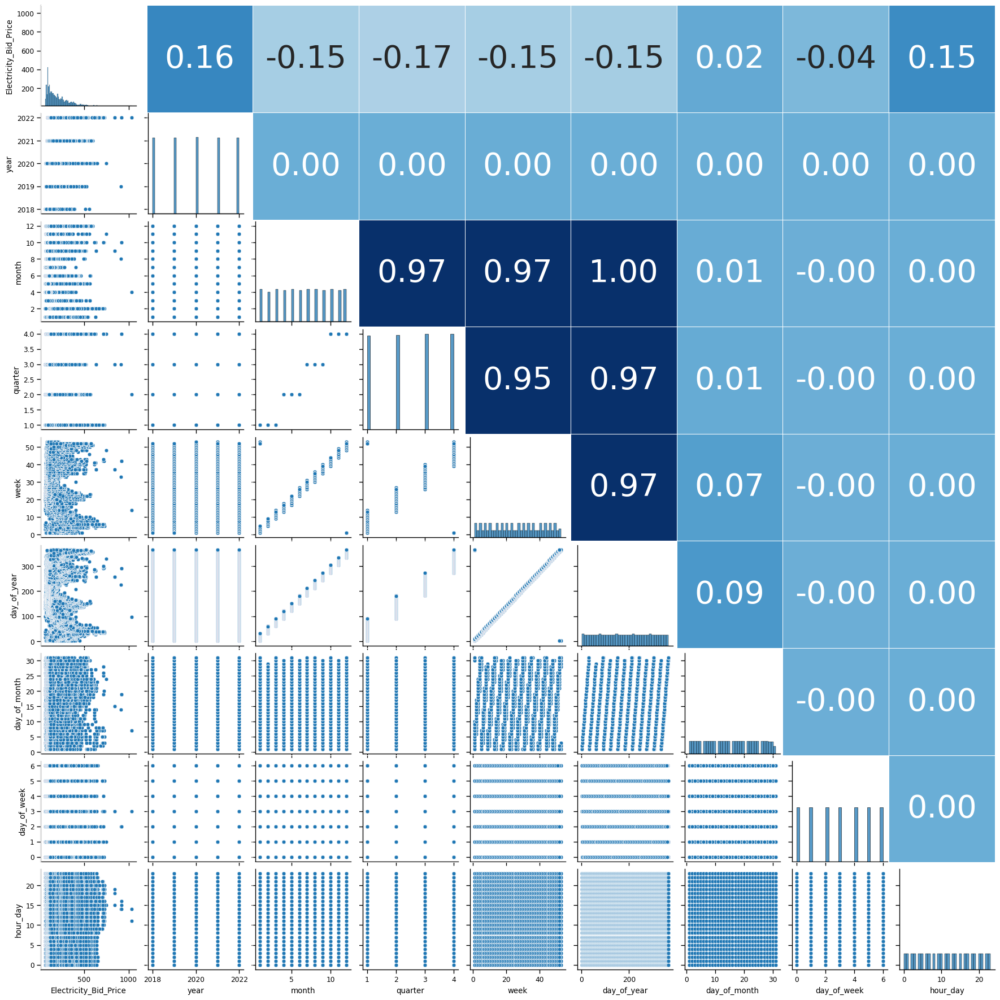

In [19]:
def hide_axis(*args, **kwds):
    plt.gca().set_visible(False)

correlacion = datosPB_EDA.corr(method="spearman")
CorrPair = sns.pairplot(datosPB_EDA, height=2)
CorrPair.map_upper(hide_axis)

(xmin, _), (_, ymax) = CorrPair.axes[0, 0].get_position().get_points()
(_, ymin), (xmax, _) = CorrPair.axes[-1, -1].get_position().get_points()

ax = CorrPair.fig.add_axes([xmin, ymin, xmax - xmin, ymax - ymin], facecolor='none')

mask1 = np.tril(np.ones_like(correlacion, dtype=bool))
sns.heatmap(correlacion, mask=mask1,
            cmap='Blues', vmax=.5, vmin=-.5, fmt=".2f",
            linewidths=.5, cbar=False, annot=True, annot_kws={'size': 40}, ax=ax)
ax.set_xticks([])
ax.set_yticks([])

plt.show()

# Analisis de Series de Tiempo

Despues de realizar un analisis de datos convencional, este apartado se enfoca concretamente en el analsis de series de tiempo con el fin de determinar patrones en estos datos. Se realizará lo siguiente:

* Descomposición de la serie de tiempo por modelo aditivo, se evidencia que la serie responde correctamente a este metodo.

* Analisis de estacionareidad por la prueba de Dickey Fuller aumentado (ADF), con el fin de determinar si la serie de datos requiere preprocesamientos adicionales para modelos de regresión

* Función de Autocorrelacion, para determinar el numero de retrasos necesarios para representar adecuadamente los patrones temporales en para un modelo de regresión

## Seasonal Decomposition

Como elemento inicial, se realiza una descomposición estacional por medio de un modelo aditivo. Esto implica que los componentes de una serie de tiempo que son la tendencia, la estacionalidad y los residuos al sumarse entre si pueden reconstruir integralmente esta serie de tiempo.

Se puede observar incialmente que no hay una tendencia ascendente o descendente puramente definida, sino una combinación de tendencias al mismo tiempo, lo que la hace una serie compleja en este sentido. A este elemento se le considera tambien el comportamiento a largo plazo de la serie de tiempo.

Por otra parte, el componente estacional refleja algo presenciado en el analisis convencional: el patron repetido de comportamiento del precio cada 24 horas. Este hallazgo brinda indicio de la cantidad de elementos necesarios para replicar el comportamiento de esta serie en un eventual modelo de regresión.

Por último, el componente residual evidencia la alta variabilidad de la serie de tiempo en si mostrada en el analisis convencional. Esto sugiere la aplicación de metodos de regresión robustos para obtener resultados satisfactorios.

In [20]:
res = seasonal_decompose(datosPB, model='additive', period=24)

In [21]:
title:str="Seasonal Decomposition"
figPBm = make_subplots(rows=4, cols=1, subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"],)
figPBm.append_trace(go.Scatter(x=res.observed.index, y=res.observed, mode="lines", name='Observed'),row=1,col=1)
figPBm.append_trace(go.Scatter(x=res.observed.index, y=res.trend, mode="lines", name='Trend'),row=2,col=1)
figPBm.append_trace(go.Scatter(x=res.observed.index, y=res.seasonal, mode="lines", name='Seasonal'),row=3,col=1)
figPBm.append_trace(go.Scatter(x=res.observed.index, y=res.resid, mode="lines", name='Residual'),row=4,col=1)
figPBm.update_layout(title=f'<b>{title}</b>',
                    margin={'t':100}, title_x=0.5,
                    #paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    width=1500,height=1300,
                    yaxis=dict(color="black"),
                    xaxis=dict(color="black"),
                    font=dict(family="Fira Sans, Condensed", color='black'),
                    showlegend=False)
figPBm.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=False)
figPBm.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=False)
figPBm.show('svg')

## Test de Estacionareidad: Prueba ADF

A partir de los datos, se realiza una prueba Dickey-Fuller aumentada para determinar la estacionareidad. Para ello determina si una serie temporal presenta raíz unitaria, lo que indica que la serie no es estacionaria.

La estacionariedad es una propiedad importante en el análisis de series temporales, ya que muchas técnicas y modelos de regresión asumen que la serie es estacionaria. Esto implica que en caso negativo, se requiere preprocesamiento adicional.

Las pruebas realizadas arrojan que en escenarios donde el p-valor asociado con la prueba, es menor que un umbral predefinido (0.05 o 0.1), rechazando así la hipótesis nula y concluyendo que la serie es estacionaria. Para este tipo de series el umbral del 5% es una buena unidad de medida. No obstante al realizar esta prueba con el umbral del 1% (valor critico maximo), esta premisa no se cumple.

Esto implica que para usarse en modelos de regresion, requiere al menos una estandarización de los datos para tener resultados confiables



In [22]:
result = adfuller(datosPB, autolag='AIC',  regression="n")
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
print(f'n_lags: {result[2]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')
    if result[0] <= value:
      print("Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.")
    else:
      print("Weak evidence aganist Null Hypothesis. So, accept Null Hypothesis and conclude data is non-stationary.")

ADF Statistic: -1.9609049038713626
p-value: 0.04767214219678823
n_lags: 55
Critial Values:
   1%, -2.5657910848763654
Weak evidence aganist Null Hypothesis. So, accept Null Hypothesis and conclude data is non-stationary.
Critial Values:
   5%, -1.9410061386598967
Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.
Critial Values:
   10%, -1.6168139330560118
Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.


## Autocorrelation Function

Para identificar mas patrones en la serie de forma explicita, se emplea la función de autocorrelación (ACF), la cual muestra la correlación entre una observación y sus valores rezagados a diferentes intervalos de tiempo. Ayuda a identificar patrones repetitivos y dependencia en los datos a medida que aumenta el intervalo de rezago.

La ACF puede mostrar la presencia de una tendencia, una estacionalidad o un componente de memoria a corto plazo en la serie de tiempo. Esto es útil para seleccionar el rezago apropiado en modelos AR (autoregresivos) o modelos de media móvil (MA) en la construcción de modelos de regresión.

Este metodo confirma las observaciones brindadas en la descomposición temporal de la serie y el analisis convencional, mostrando el mayor indice de correlacion cada 24 muestras, siendo consecuente con el comportamiento de esta serie durante un día de forma horaria.

In [23]:
def create_corr_plot(series, plot_pacf=True, lags=40):
    corr_array = pacf(series.dropna(), alpha=0.05) if plot_pacf else acf(series.dropna(), alpha=0.05, fft=False, nlags=lags)
    lower_y = corr_array[1][:,0] - corr_array[0]
    upper_y = corr_array[1][:,1] - corr_array[0]
    fig = go.Figure()
    [fig.add_scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='#3f3f3f')
     for x in range(len(corr_array[0]))]
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='#1f77b4',
                   marker_size=12)
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(255,255,255,0)')
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(32, 146, 230, 0.3)',
            fill='tonexty', line_color='rgba(255,255,255,0)')
    fig.update_traces(showlegend=False)
    fig.update_xaxes(range=[-1,lags+2])
    fig.update_yaxes(zerolinecolor='#000000')

    title='Partial Autocorrelation (PACF)' if plot_pacf else ''

    fig.update_layout(title=title,
                      #paper_bgcolor='rgba(0,0,0,0)',
                      plot_bgcolor='rgba(0,0,0,0)',
                      width=1000,height=530,
                      yaxis=dict(color="black"),
                      xaxis=dict(color="black"),
                      font=dict(family="Fira Sans, Condensed", color='black'),
                      showlegend=False)

    fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=False, title_text='<b>Time lags (1 hr interval)</b>', titlefont_size=30, tickfont_size=28, tickmode = 'linear', tick0 = 0, dtick = 100)
    fig.update_yaxes(showline=True, linewidth=1, gridcolor='lightgray', linecolor='black', mirror=False, title_text='<b>Autocorrelation</b>', titlefont_size=30, tickfont_size=28)
    fig.show('svg')

In [24]:
create_corr_plot(datosPB,False,48)

# Regresión

## Preprocesamiento de datos



## División del Dataset

En este caso, al ser una serie temporal la división de datos se debe hacer consecuentemente a su organización. Por lo tanto en vez de usar train-test split, esta división se ha realizado manuamente tomando como datos de prueba el ultimo año de datos (2022).

In [25]:
fin_train = '2021-12-31 23:00:00'
inicio_prueba = '2022-01-01 00:00:00'

datosPB_train = datosPB.loc[: fin_train, :]
datosPB_test = datosPB.loc[inicio_prueba:, :]

train_size = datosPB_train.shape[0]
test_size = datosPB_test.shape[0]

print(f"Fechas train      : {datosPB_train.index.min()} --- {datosPB_train.index.max()}")
print(f"Fechas test       : {datosPB_test.index.min()} --- {datosPB_test.index.max()}")

Fechas train      : 2018-01-01 00:00:00 --- 2021-12-31 23:00:00
Fechas test       : 2022-01-01 00:00:00 --- 2022-12-31 23:00:00


## Conversión de series de tiempo a aprendizaje supervisado

Para esta conversión, se emplea el metodo de ventana deslizante (sliding window method), donde estos datos unidimensionales se convierten en vectores autorregresivos multidimensionales, lo que representa nuevas características para la estimación de modelos de regresión.

Considerando el analisis convencional y de series de tiempo realizados previamente, se tendran en cuenta los precios de electricidad de las 24 horas previas al valor al predecir.

In [26]:
time_lags = 24
f_window = 1

In [27]:
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
   n_vars = 1 if type(data) is list else data.shape[1]
   df = pd.DataFrame(data)
   cols, names = list(), list()
   # input sequence (t-n, ... t-1)
   for i in range(n_in, 0, -1):
    cols.append(df.shift(i))
    names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
   # forecast sequence (t, t+1, ... t+n)
   for i in range(0, n_out):
    cols.append(df.shift(-i))
    if i == 0:
      names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
    else:
      names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
      agg.dropna(inplace=True)
   return agg

In [28]:
data_train, data_test = series_to_supervised(datosPB_train, time_lags, f_window), series_to_supervised(datosPB_test, time_lags, f_window)
X_train, X_test = data_train.iloc[:, :time_lags].reset_index(drop=True), data_test.iloc[:, :time_lags].reset_index(drop=True)
y_train, y_test = data_train.iloc[:, time_lags:].reset_index(drop=True), data_test.iloc[:, time_lags:].reset_index(drop=True)
print(X_train.shape,  X_test.shape, y_train.shape, y_test.shape)

(35040, 24) (8736, 24) (35040, 1) (8736, 1)


### Union de caracteristicas autoregresivas con las encontradas en el analisis convencional

In [29]:
#Incorporamos al modelo las variables que tenian un indice de correlacion significativo en el analisis convencional para elaborar el modelo.
datosPB_sec_EDA_train = datosPB_EDA.loc[datosPB_EDA.index[24]:datosPB_EDA.index[35063], ['year', 'hour_day', 'quarter']].reset_index(drop=True)
datosPB_sec_EDA_test = datosPB_EDA.loc[datosPB_EDA.index[24+35064]:datosPB_EDA.index[35064+8759], ['year', 'hour_day', 'quarter']].reset_index(drop=True)

In [30]:
X_train = pd.concat([X_train, datosPB_sec_EDA_train], axis=1)
X_test = pd.concat([X_test, datosPB_sec_EDA_test], axis=1)

### Estandarización de los datos

In [31]:
Stdscaler = StandardScaler()
Stdscaler = Stdscaler.fit(X_train)
datosPB_train_Reg = Stdscaler.transform(X_train)
datosPB_test_Reg = Stdscaler.transform(X_test)

## Modelos

A continiuación se comprueba el rendimiento de 2 modelos de predicción con el conjunto de datos empleado:

*   Regresión Lineal Multiple
*   Regresión Polinomial



### Lineal Multiple

El primer modelo representa una combinación lineal entre los retrasos de las 24 horas y las variables obtenidas en ingeniería de caracteristicas, Este modelo presenta 28 variables, incluido el intercepto.

In [32]:
MLR_regressor = LinearRegression()
MLR_regressor.fit(datosPB_train_Reg, y_train)
print("\nPendientes:\n",MLR_regressor.coef_)
print("\nIntercepto:\n",MLR_regressor.intercept_)


Pendientes:
 [[ 5.98226130e+00  1.37134127e+01  1.37620929e+00  9.71378276e-01
   3.38427163e+00  4.66891909e+00 -4.67265606e+00  1.57369943e+00
   2.72181859e+00 -1.33785236e+00  2.01439205e+00  2.07212786e+00
  -3.60765235e+00 -2.07277050e-02 -9.25045333e-02 -2.06669710e+00
   7.04091484e-01  2.06231871e+00 -4.23424597e+00 -1.11408255e-01
   3.53819959e+00  3.70561131e+00  1.84334355e+00  7.24979238e+01
   2.18668887e-02  4.89077108e-01  8.19368865e-02]]

Intercepto:
 [186.52122511]


In [33]:
prediction_test_LR = MLR_regressor.predict(datosPB_test_Reg)

### Polinómica

El segundo modelo representa una combinación lineal polinomica de grado 2, entre los retrasos de las 24 horas y las variables obtenidas en ingeniería de caracteristicas, Este modelo de regresión presenta 407 características (incluido intercepto).

In [34]:
poly = PolynomialFeatures(degree=2, interaction_only=False)
poly_con = poly.fit(datosPB_train_Reg)
datosPB_train_Poly = poly.transform(datosPB_train_Reg)
datosPB_test_Poly = poly.transform(datosPB_test_Reg)
#poly_con.get_feature_names_out()

In [35]:
PR_regressor = LinearRegression()
PR_regressor.fit(datosPB_train_Poly, y_train)
print("\nPendientes:\n",PR_regressor.coef_)
print("\nIntercepto:\n",PR_regressor.intercept_)


Pendientes:
 [[-4.30478874e-15  6.88934193e+00  7.97420339e+00 -9.32102098e-01
   3.85733702e-01  3.96048632e-01  1.62540196e+00 -3.81211049e+00
   8.83305572e-01  1.82402605e+00  1.56078516e+00  2.08918162e+00
   3.40220020e+00 -1.80443040e+00 -1.36793812e+00 -4.37010841e-01
   9.60886743e-02  1.45444801e+00  2.81166533e+00  1.41207281e+00
   1.51355707e+00  5.77280575e+00  3.14372402e+00 -4.17644882e-02
   7.21656443e+01  1.02982875e-01  1.03507390e+00  1.62816158e-01
  -1.61126728e+00  5.44415922e+00  5.33819388e+00  6.75334002e+00
   2.47540444e+00 -8.75857050e+00 -7.97249571e+00 -1.15068988e+00
   4.33085753e+00  2.19096863e+00 -4.88833969e+00  5.49793028e+00
  -5.46872218e+00 -2.44121117e+00  4.70376385e+00 -7.19348870e+00
  -5.40831807e+00  8.43107814e+00  1.25000141e+01 -6.19734437e+00
   3.85658235e+00 -1.03613759e+01 -3.65580843e+00  3.22445481e+00
   5.54812568e-01  4.16714056e+00 -1.05813793e-01 -1.60528557e+00
  -1.64562562e-01 -7.49032140e+00  8.15311369e+00 -5.56563149e

In [36]:
prediction_test_PR = PR_regressor.predict(datosPB_test_Poly)

### Análisis de Rendimiento

Los resultados de forma general evidencian que la regresion lineal multiple (MLR) es suficiente para establecer el comportamiento de mejor forma. De hecho, segun el coeficiente R2, se puede explicar mas del 93% de los precios con este modelo (sobre el 92% del polinomial). Es un metodo mas sencillo, preciso acorde a lo que se necesita y mas preciso en este caso.

Se evidencia tambien en la distribución de errores, la tendencia del modelo MLR en ubicar sus errores cercanos a cero de forma simetrica, lo que indica el buen comportamiento del modelo y la idoneidad de la estandarizacion como paso del preprocesamiento de estos datos. Las diferencias de rendimiento fueron bastante pequeñas para este caso.

Se recomienda contrastar estos modelos con otras tecnicas tanto de ML como de analisis temporal para comprobar el rendimiento de forma mas criteriosa.

#### Grafico

In [37]:
figPBCom = make_subplots(rows=1, cols=1)


figPBCom.append_trace(go.Scatter(y=y_test.values.ravel(), x=datosPB_test.index[time_lags-1:],
                                 mode='lines', line=dict(width=2, color="blue"),
                                 name="Test data", stackgaps='infer zero'), row=1, col=1)
figPBCom.append_trace(go.Scatter(y=prediction_test_PR.ravel(), x=datosPB_test.index[time_lags-1:],
                                 mode='lines', line=dict(width=2, color="red"),
                                 name="Polynomial Regression", stackgaps='infer zero'), row=1, col=1)
figPBCom.append_trace(go.Scatter(y=prediction_test_LR.ravel(), x=datosPB_test.index[time_lags-1:],
                                 mode='lines', line=dict(width=2, color="gold"),
                                 name="Multiple Linear Regression", stackgaps='infer zero'), row=1, col=1)


figPBCom.update_layout(title='',
                      #paper_bgcolor='rgba(0,0,0,0)',
                      plot_bgcolor='rgba(0,0,0,0)',
                      width=1200,height=700,
                      yaxis=dict(color="black"),
                      xaxis=dict(color="black"),
                      font=dict(family="Fira Sans, Condensed", color='black'),
                      legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, font_size=35, font_color='black'),
                      showlegend=True)
figPBCom.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='lightgray', mirror=False, title_text='<b>Time (1 hour)</b>', titlefont_size=35, tickfont_size=28)
figPBCom.update_yaxes(showline=True, linewidth=1, gridcolor='lightgray', linecolor='black', mirror=False, title_text='<b>Electricity Spot Price ($COP/kWh)</b>', titlefont_size=35, tickfont_size=28)
figPBCom.update_traces(connectgaps=False)
figPBCom.update_annotations(font=dict(size=35))
figPBCom.show('svg')

#### Métricas

In [38]:
mse_LR = mean_squared_error(y_test, prediction_test_LR)
mse_PR = mean_squared_error(y_test, prediction_test_PR)

rmse_LR = np.sqrt(mse_LR)
rmse_PR = np.sqrt(mse_PR)

R2_LR = r2_score(y_test, prediction_test_LR)
R2_PR = r2_score(y_test, prediction_test_PR)


print(f"MSE: Multiple Linear Regression {mse_LR:.4f} - Polynomial Regression {mse_PR:.4f}")
print(f"RMSE: Multiple Linear Regression {rmse_LR:.4f} - Polynomial Regression {rmse_PR:.4f}")
print(f"R2: Multiple Linear Regression {R2_LR:.4f} - Polynomial Regression {R2_PR:.4f}")

MSE: Multiple Linear Regression 1100.7461 - Polynomial Regression 1193.4943
RMSE: Multiple Linear Regression 33.1775 - Polynomial Regression 34.5470
R2: Multiple Linear Regression 0.9317 - Polynomial Regression 0.9260


#### Distribución de Errores

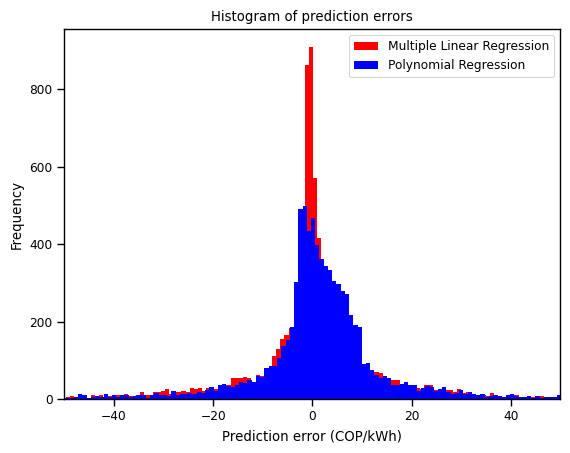

In [39]:
diff_LR = y_test - prediction_test_LR
diff_PR = y_test - prediction_test_PR
plt.hist(diff_LR, bins = 1500, color='r', label='Multiple Linear Regression')
plt.hist(diff_PR, bins = 1500, color='b', label='Polynomial Regression')
plt.title('Histogram of prediction errors')
plt.legend()
plt.xlim(-50,50)
plt.xlabel('Prediction error (COP/kWh)')
plt.ylabel('Frequency')
plt.show()